In [1]:
import numpy as np
import pandas as pd
import sys
import pickle
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.rcParams["figure.dpi"]= 300
mpl.rc('axes.spines',top=False,bottom=False,left=False,right=False);
mpl.rc('axes',facecolor=(0,0,0,0),edgecolor=(0,0,0,0));
mpl.rc(('xtick','ytick'),color=(0,0,0,0));
import time
import PIL
import os
import json
from annoy import AnnoyIndex
import subprocess

import tensorflow
import tensorflow as tf
import tensorflow.keras as keras
import tensorflow.keras.applications as ka
from keras.applications.resnet import decode_predictions

class searchEngine():

    def __init__(self, encoding_user_set = 'resnet_1000', combined_weight = 1):

        self.class_key = pd.read_csv('/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/imagenet_resnet_key.csv')
        self.encoding_type = encoding_user_set
        self.set_src()
        self._tree_count = None
        self._combined_resnet_weight = 0.3
        self._combined_weight = combined_weight
        try:
            self.load_database()
        except:
            print('Must generate encodings for this setting.')

    def brute_force_search_index(self, query_index, num_results, show_flag=1, normalized=False):

        # Query vector:
        query_vec = self._values[query_index]

        # Query key:
        query_key = self._keys[query_index]

        # Begin timer:
        start_time = time.time()

        # Use Numpy to calculate distance values:
        dist_to_query = []
        if normalized == True:
            dist_to_query = np.linalg.norm((query_vec/np.linalg.norm(query_vec) - 
                                            np.array(searcher._values)/np.linalg.norm(np.array(searcher._values), axis = 1).reshape(-1, 1)), axis = 1)
        else:
            dist_to_query = np.linalg.norm((query_vec - np.array(self._values)), axis = 1)

        # Rank by distance:
        dist_ranking = np.argsort(dist_to_query)

        # End timer:
        end_time = time.time()
            
        if show_flag == 1:
            self.show_results(query_index, dist_ranking, num_results)

    def show_results(self, query_idx, dist_rank, num_results, query_filepath = None):
        
        if query_filepath == None:
            query_img = PIL.Image.open(self._image_dir + self._keys[query_idx])
        else:
            query_img = PIL.Image.open(query_filepath)

        print(self._keys[query_idx])
        
        

        concat_img = np.array(query_img.resize((int((600/query_img.height)*query_img.width), 600)))

        for i in range(1, num_results + 1):
            result_idx = dist_rank[i]
            result_img = PIL.Image.open(self._image_dir + self._keys[result_idx])
            result_img = result_img.resize((int((600/result_img.height)*result_img.width), 600))

            if len(np.array(result_img).shape) == 2:
                result_img = np.stack([result_img, result_img, result_img], axis = -1)
            elif np.array(result_img).shape == (224, 224, 4):
                result_img = np.array(result_img)
                result_img = result_img[:, :, 0:3]


            concat_img = np.concatenate([concat_img, np.zeros((600, 60, 3)), result_img], axis = 1)

            print(self._keys[result_idx])

        plt.clf()
        plt.imshow(concat_img/255)
        plt.show()
        
    def annoy_search_index(self, query_index, num_results, show_flag=1):
        
        # Query vector:
        query_vec = np.array(self._values[query_index])

        # Query key:
        query_key = self._keys[query_index]

        # Begin timer:
        start_time = time.time()

        # Rank by distance:
        dist_ranking = self._annoy_forest.get_nns_by_vector(query_vec, num_results+1)

        # End timer:
        end_time = time.time()
        
        if show_flag == 1:
            self.show_results(query_index, dist_ranking, num_results)


    def distributed_search(self, query_index, num_results, cluster_id = 'local'):

        # Query vector:
        query_vec = self._values[query_index]
        query_vec_str = ''
        for elem in query_vec:
            query_vec_str += str(elem) + ' '
        query_vec_str = query_vec_str[:-1]
    #         print(query_vec_str)

        f = open("vec.txt","w")
        f.write(query_vec_str)

        if cluster_id == 'local':
            print('Running locally')
            subprocess.run("python3 distributed_prototype_local.py " + 
                           str(self._src) + 
                           " -r local " + 
                           "--region=us-east-2 --query=vec.txt > output.txt", 
                           shell = True)
        else:

            subprocess.run("python3 distributed_prototype.py " + 
                           str(self._s3_path) + 
                           " -r emr --cluster-id=" + 
                           str(cluster_id) + 
                           " --no-read-logs --region=us-east-2 --query=vec.txt > output.txt", 
                           shell = True)


#         with open('output.txt') as f:
#             for line in f:
#                 out = list(str(line).replace('[','').
#                                      replace(']','').
#                                      replace(',', '').
#                                      replace('"','').
#                                      replace('1\t','').
#                                      replace('\n', '').split(" "))

# #         print(out[1::2])
#         out_paths = out[1::2]
#         if show_flag == 1:
#         for item in out[1::2]:
#             img = PIL.Image.open(searcher._image_dir + item)

#             plt.clf()
#             plt.imshow(img)
#             plt.show()
#         query_img = PIL.Image.open(self._image_dir + out_paths[0])

#         concat_img = np.array(query_img.resize((int((600/query_img.height)*query_img.width), 600)))

#         for i in range(1, num_results + 1):
#             result_path = out_paths[i]
#             result_img = PIL.Image.open(self._image_dir + result_path)
#             result_img = result_img.resize((int((600/result_img.height)*result_img.width), 600))

#             if len(np.array(result_img).shape) == 2:
#                 result_img = np.stack([result_img, result_img, result_img], axis = -1)
#             elif np.array(result_img).shape == (224, 224, 4):
#                 result_img = np.array(result_img)
#                 result_img = result_img[:, :, 0:3]


#             concat_img = np.concatenate([concat_img, np.zeros((600, 60, 3)), result_img], axis = 1)

#         plt.clf()
#         plt.imshow(concat_img/255)
#         plt.show()
        
    def build_annoy_forest(self, tree_count, seed = 13):
        
        self._tree_count = tree_count
        t = AnnoyIndex(len(self._values[0]), 'euclidean')
        t.set_seed(seed)

        for idx, item in enumerate(self._values):
            t.add_item(idx, np.array(item))
            
        t.build(tree_count)
        self._annoy_forest = t

    def load_database(self):

        with open(self._src) as f:
            db =  json.load(f)

        self._values = np.array([x for x in db.values()])
        self._keys = list(db.keys())
        
        if self.encoding_type == 'combined':
            
            resnet_enc_norm = self._values/np.linalg.norm(self._values, axis = 1).reshape(-1, 1)
            
            print(resnet_enc_norm.shape)
            
            self.encoding_type = 'ae_bottleneck_2048'
            self.set_src()
            self.encoding_type = 'combined'
            
            with open(self._src) as f:
                db =  json.load(f)
            
            ae_enc_norm = np.array([x for x in db.values()])/np.linalg.norm(np.array([x for x in db.values()]),
                                                                            axis = 1).reshape(-1, 1)
            
#             print(ae_enc_norm.shape)
            
            self._values = np.concatenate([self._combined_weight*resnet_enc_norm, ae_enc_norm], axis = 1)
            
            print(self._values.shape)
            
        elif self.encoding_type == 'resnet_1000_normalized':
            
            self._values = self._values/np.linalg.norm(self._values, axis = 1).reshape(-1, 1)
            
        
    def load_encoder(self):
        '''
        Loads the original model and uses its paramemters to compile the encoding layers.
        
        Only available for relevant encoding types.
        '''
        
        if self.encoding_type == 'resnet_1000' or self.encoding_type == 'resnet_1000_scaled_up':
            self._encoderModel = ka.ResNet50(weights='imagenet',
                                             input_shape = (224, 224, 3))
            
        elif self.encoding_type == 'resnet_2048':
            self._underlyingModel = ka.ResNet50(weights='imagenet',
                                             input_shape = (224, 224, 3))

            self._encoderModel = keras.Model(inputs = self._underlyingModel.input, 
                                             outputs = self._underlyingModel.layers[-2].output)
            
        elif self.encoding_type == 'ae_simple_2048':
            self._underlyingModel = keras.models.load_model(
                                    './models/AE_Simple_F4_0001_Final.h5')

            self._encoderModel = keras.Model(inputs = self._underlyingModel.input, 
                                             outputs = keras.layers.GlobalMaxPool2D()
                                             (self._underlyingModel.layers[-12].output))
            
        elif self.encoding_type == 'ae_dense_2048':
            self._underlyingModel = keras.models.load_model(
                                    './models/AE_Dense_F4_0001_Final.h5')

            self._encoderModel = keras.Model(inputs = self._underlyingModel.input, 
                                             outputs = self._underlyingModel.layers[-9].output)
            
        elif self.encoding_type == 'ae_bottleneck_2048' or self.encoding_type == 'ae_bottleneck_2048_scaled_up':
            self._underlyingModel = keras.models.load_model(
                                    './models/AE_Bottleneck_F4_0001_Final.h5')
    
            self._encoderModel = keras.Model(inputs = self._underlyingModel.input,
                                             outputs = self._underlyingModel.layers[-15].output)
        
        elif self.encoding_type == 'combined':
            
            self._underlyingModel = keras.models.load_model(
                                    './models/AE_Bottleneck_F4_0001_Final.h5')
    
            self._encoderModel = keras.Model(inputs = self._underlyingModel.input,
                                             outputs = self._underlyingModel.layers[-15].output)
        
            self._encoderModel.compile()
            
            self._underlyingModel = ka.ResNet50(weights='imagenet',
                                           input_shape = (224, 224, 3))  
            
            self._underlyingModel.compile()
            
            print('Combined encoders loaded.')
        
        else:
            print('No model matching that encoding type.')
            return

        self._encoderModel.compile()

    def prep_image(self, path):
    
        im = PIL.Image.open(path)
        im_resize = im.resize((224, 224))
        if np.array(im_resize).shape == (224, 224):
            im_resize = np.stack([im_resize, im_resize, im_resize], axis = -1)
        elif np.array(im_resize).shape == (224, 224, 4):
            im_resize = np.array(im_resize)
            im_resize = im_resize[:, :, 0:3]
        
        return np.array(im_resize).reshape((1, 224, 224, 3))
    
    def encoder_search(self, query_path, num_results, show = 1):
        
        np_image = self.prep_image(query_path)
        
        if self.encoding_type == "combined":
            resnet_encoding = self._underlyingModel.predict(np_image)
            ae_encoding = self._encoderModel.predict(np_image)
            resnet_enc_norm = resnet_encoding/np.linalg.norm(resnet_encoding).reshape(-1, 1)
            ae_enc_norm = ae_encoding/np.linalg.norm(ae_encoding).reshape(-1, 1)
            query_encoding = np.concatenate([self._combined_weight*resnet_enc_norm, ae_enc_norm], axis = 1)
        else:
            query_encoding = self._encoderModel.predict(np_image)
        
#         if self._tree_count == None:
#             self.build_annoy_forest(10)
        
#         print(query_encoding[0])
        # Rank by distance:
        dist_ranking = self._annoy_forest.get_nns_by_vector(query_encoding[0], num_results+1)

        self.show_results(0, dist_ranking, num_results, query_filepath = query_path)
            
    def generate_reconstruction(self, image_path):
        '''
        Generate a reconstructed images using an autoencoder model.
        
        Note that in order to show parity between the input and the reconstructed image,
        we plot the resized 224 x 224 x 3 image in both cases:
        '''
        
        if self.encoding_type not in {"ae_bottleneck_2048", "ae_dense_2048", "ae_simple_2048"}:
            print("Reconstruction is only available for autoencoder models.")
        else:
            np_image = self.prep_image(image_path)
            
            plt.clf()
            plt.imshow(np_image[0]/255)
            plt.show()
            
            reconstructed_image = self._underlyingModel(np_image)
        
            plt.clf()
            plt.imshow(reconstructed_image[0]/255)
            plt.show()
            
    def save_scores(self, search_mode = 'annoy', normalized = False, ranks = [5, 10, 20, 50], num_classes=1000):
        '''
        Scores encodings by ImageNet class as mean average precision.

        Only valid for validation directories - otherwise leaky.
        '''
        
        # Precompute normalization of each encoding:
        # Saves a lot of runtime.
        if normalized == True:
            self._values_normed = self._values/np.linalg.norm(self._values, axis = 1).reshape(-1, 1)

        # Dictionary keeps track of scores by class:
        score_dict = {}

        for idx in range(num_classes*50):
            
            if idx % 1000 == 0:
                print(idx)

            # Query info:
            query_vec = self._values[idx]
            query_key = self._keys[idx]
            query_class = query_key[:query_key.find('/')]

            # Begin timer:
            start_time = time.time()

            # Calculate distance values:
            dist_to_query = []

            if search_mode == 'brute_force':
                if normalized == True:
                    dist_to_query = np.linalg.norm((query_vec/np.linalg.norm(query_vec) - 
                                                    self._values_normed), 
                                                    axis = 1)
                else:
                    dist_to_query = np.linalg.norm(query_vec - self._values, 
                                                   axis = 1)
                # Rank by distance:    
                dist_ranking = np.argsort(dist_to_query)
            elif search_mode == 'annoy':
                dist_ranking = self._annoy_forest.get_nns_by_vector(query_vec, np.max(ranks) + 1)
            else:
                print("Not a valid search mode")
                return

            # End timer:
            end_time = time.time()

            # Compare classes:
            correct = 0
            rank_idx = 0
            # Note: First result is the image itself, so we skip it.
            for jdx in range(1, np.max(ranks) + 1):

                result_key = self._keys[dist_ranking[jdx]]
                result_class = result_key[:result_key.find('/')]

                if result_class == query_class:
                    correct += 1

                if ranks[rank_idx] == jdx:

                    if query_class not in score_dict:
                        score_dict[query_class] = {}
                        score_dict[query_class][ranks[rank_idx]] = []
                    elif ranks[rank_idx] not in score_dict[query_class]:
                        score_dict[query_class][ranks[rank_idx]] = []

                    score_dict[query_class][ranks[rank_idx]].append(correct/ranks[rank_idx])#, end_time - start_time))

                    rank_idx += 1
                
                score_dict['time'] = end_time - start_time
                
        if search_mode == 'annoy' and self._combined_weight == 1:
            with open(search_mode + "_" + str(self._tree_count) + "_" + self.encoding_type + "_scores.txt", 'w') as outfile:
                json.dump(score_dict, outfile)
        elif search_mode == 'annoy' and self._combined_weight == 0.5:
            with open(search_mode + "_" + str(self._tree_count) + "_" + self.encoding_type + "_0.5_scores.txt", 'w') as outfile:
                json.dump(score_dict, outfile)
        else:
            if normalized == True:
                with open(search_mode + "_normalized_" + self.encoding_type + "_scores.txt", 'w') as outfile:
                    json.dump(score_dict, outfile)        
            else:
                with open(search_mode + "_" + self.encoding_type + "_scores.txt", 'w') as outfile:
                    json.dump(score_dict, outfile)         


    def score_runtimes(self, search_mode, c_id = 'j-22JGSV587G1E1'):
        
        runtimes = []
        rand_index = np.random.randint(0, 50000, (1000,))

        for i in range(100):
            idx = rand_index[i]
            
            # Query info:
            query_vec = self._values[idx]
            query_key = self._keys[idx]
            query_class = query_key[:query_key.find('/')]

            # Calculate distance values:
            dist_to_query = []
            
            # Begin timer:
            start_time = time.time()

            if search_mode == 'brute_force':

                dist_to_query = np.linalg.norm(query_vec - self._values, 
                                               axis = 1)
                # Rank by distance:    
                dist_ranking = np.argsort(dist_to_query)
            elif search_mode == 'annoy':
                dist_ranking = self._annoy_forest.get_nns_by_vector(query_vec, 50)
            elif search_mode == 'distributed':
                self.distributed_search(idx, 50, cluster_id = c_id)
            else:
                print("Not a valid search mode")
                return

            # End timer:
            end_time = time.time()
            
            runtimes.append(end_time - start_time)
        return np.mean(runtimes), np.var(runtimes)
            
        
    def generate_encodings(self):
        '''
        Generates encodings based on user supplied encoding type and loaded encoder.
        
        Be careful when using this functionality - it will overwrite existing encodings.
        '''

        files_all = []
        
        if self.encoding_type != 'ae_bottleneck_2048_scaled_up' and self.encoding_type != 'resnet_1000_scaled_up':
            for i in range(1,1001):
                files = os.listdir(self._image_dir + str(i))  # Get all the files in that directory
                files_all += [str(i) + '/' + x for x in files]
        else:
            for class_folder in self.class_key['train_id'].values:
                
                files = os.listdir(self._image_dir + class_folder)  # Get all the files in that directory
                files_all += [class_folder + '/' + x for x in files]
            
                
        encodings_dict = {}

        for idx in range(len(files_all)):

            if idx % 1000 == 0:
                print(idx)
            
            try:
                path = self._image_dir + files_all[idx]
                im = PIL.Image.open(path)
                im_resize = im.resize((224, 224))
                if np.array(im_resize).shape == (224, 224):
                    im_resize = np.stack([im_resize, im_resize, im_resize], axis = -1)
                elif np.array(im_resize).shape == (224, 224, 4):
                    im_resize = np.array(im_resize)
                    im_resize = im_resize[:, :, 0:3]
                np_im = np.array(im_resize).reshape((1, 224, 224, 3))

                out = self._encoderModel.predict(np_im)

                encodings_dict[files_all[idx]] = list([float(x) for x in out[0]])
            except:
                print('Skipping one image.')
    
        with open(self._src, 'w') as outfile:
            json.dump(encodings_dict, outfile)
        
    def set_src(self):
        '''
        Sets a hardcoded path according to user encoding type setting.
        '''
        
        if self.encoding_type == 'resnet_1000':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/validation_pretrained_resnet/resnet50_validation_1000.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
            self._s3_path = 's3://compressedencodings/resnet50_validation_1000_pure_text.txt'
        elif self.encoding_type == 'resnet_1000_normalized':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/validation_pretrained_resnet/resnet50_validation_1000.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'resnet_2048':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/validation_pretrained_resnet/resnet50_validation_2048.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'ae_simple_2048':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/ae_simple_validation_2048.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'ae_dense_2048':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/ae_dense_validation_2048.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'ae_bottleneck_2048':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/ae_bottleneck_validation_2048.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'combined':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/validation_pretrained_resnet/resnet50_validation_1000.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'debug':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/DEBUG_ae_bottleneck_validation_2048.txt'
            self._image_dir = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'
        elif self.encoding_type == 'resnet_1000_scaled_up':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/resnet50_scaled_up_1000.txt'
            self._image_dir = '/Volumes/Samsung_T5/ImageNet/torrented_version/ILSVRC2012_img_train/'
        elif self.encoding_type == 'ae_bottleneck_2048_scaled_up':
            self._src = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/ae_bottleneck_scaled_up_2048.txt'
            self._image_dir = '/Volumes/Samsung_T5/ImageNet/torrented_version/ILSVRC2012_img_train/'

        
    def get_src(self):
        return self._src
        

# if __name__ == '__main__':




In [2]:
resnet_1000_searcher = searchEngine('resnet_1000')
resnet_1000_normalized_searcher = searchEngine('resnet_1000_normalized')
resnet_2048_searcher = searchEngine('resnet_2048')
combined_searcher = searchEngine('combined')
combined_weighted_searcher = searchEngine('combined', combined_weight = 0.5)
ae_bottleneck_searcher = searchEngine('ae_bottleneck_2048')
ae_dense_searcher = searchEngine('ae_dense_2048')
ae_simple_searcher = searchEngine('ae_simple_2048')



(50000, 1000)
(50000, 3048)
(50000, 1000)
(50000, 3048)


In [3]:
resnet_1000_searcher.build_annoy_forest(1000)
resnet_1000_normalized_searcher.build_annoy_forest(1000)
resnet_2048_searcher.build_annoy_forest(1000)
combined_searcher.build_annoy_forest(1000)
combined_weighted_searcher.build_annoy_forest(1000)
ae_bottleneck_searcher.build_annoy_forest(1000)
ae_dense_searcher.build_annoy_forest(1000)
ae_simple_searcher.build_annoy_forest(1000)

In [4]:
resnet_1000_searcher.load_encoder()
resnet_2048_searcher.load_encoder()
combined_searcher.load_encoder()
combined_weighted_searcher.load_encoder()
ae_bottleneck_searcher.load_encoder()
ae_dense_searcher.load_encoder()
ae_simple_searcher.load_encoder()

Combined encoders loaded.
Combined encoders loaded.


1/ILSVRC2012_val_00018317.JPEG
437/ILSVRC2012_val_00015200.JPEG
625/ILSVRC2012_val_00012222.JPEG
628/ILSVRC2012_val_00044056.JPEG
469/ILSVRC2012_val_00043903.JPEG
469/ILSVRC2012_val_00021775.JPEG


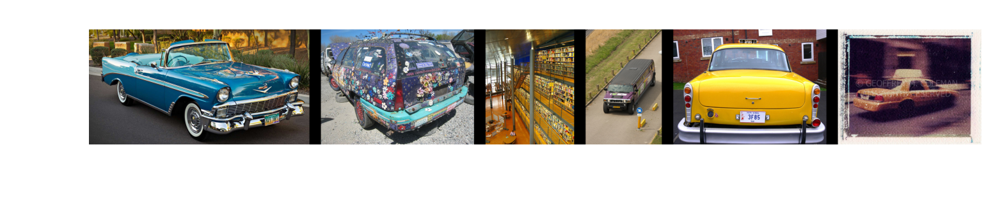

1/ILSVRC2012_val_00018317.JPEG
437/ILSVRC2012_val_00029094.JPEG
512/ILSVRC2012_val_00022770.JPEG
437/ILSVRC2012_val_00024318.JPEG
512/ILSVRC2012_val_00036091.JPEG
512/ILSVRC2012_val_00010676.JPEG


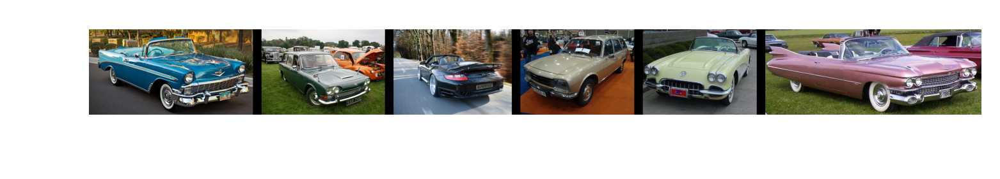

1/ILSVRC2012_val_00018317.JPEG
469/ILSVRC2012_val_00029841.JPEG
718/ILSVRC2012_val_00016098.JPEG
469/ILSVRC2012_val_00023507.JPEG
469/ILSVRC2012_val_00039097.JPEG
469/ILSVRC2012_val_00026694.JPEG


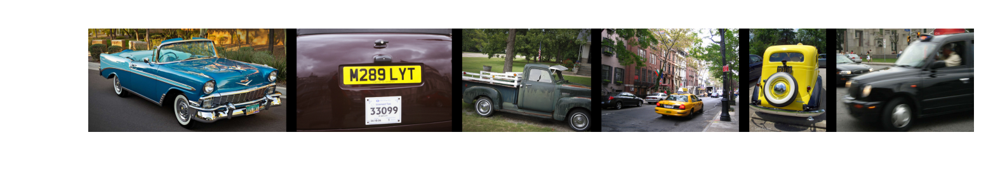

1/ILSVRC2012_val_00018317.JPEG
469/ILSVRC2012_val_00029841.JPEG
469/ILSVRC2012_val_00023507.JPEG
469/ILSVRC2012_val_00039097.JPEG
469/ILSVRC2012_val_00026694.JPEG
469/ILSVRC2012_val_00044318.JPEG


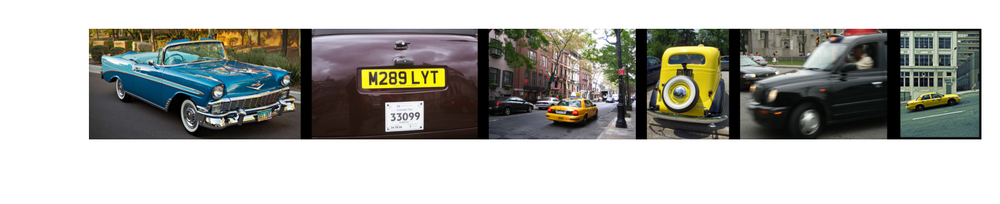

1/ILSVRC2012_val_00018317.JPEG
112/ILSVRC2012_val_00015650.JPEG
878/ILSVRC2012_val_00001895.JPEG
829/ILSVRC2012_val_00045449.JPEG
306/ILSVRC2012_val_00000342.JPEG
864/ILSVRC2012_val_00039140.JPEG


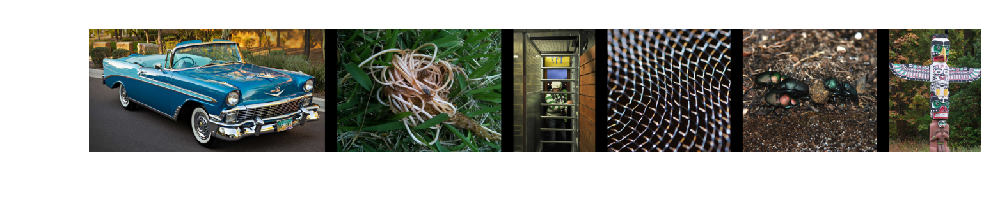

1/ILSVRC2012_val_00018317.JPEG
759/ILSVRC2012_val_00038499.JPEG
595/ILSVRC2012_val_00042991.JPEG
429/ILSVRC2012_val_00015341.JPEG
794/ILSVRC2012_val_00029858.JPEG
920/ILSVRC2012_val_00011435.JPEG


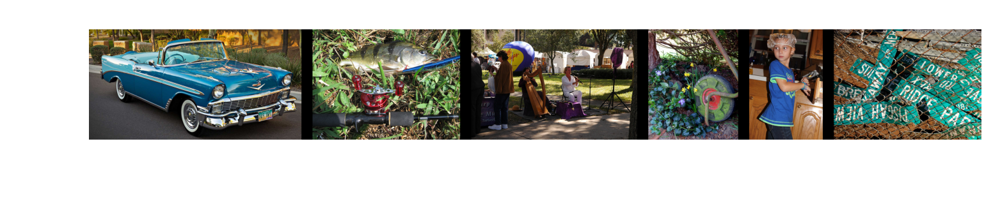

1/ILSVRC2012_val_00018317.JPEG
782/ILSVRC2012_val_00038302.JPEG
759/ILSVRC2012_val_00038499.JPEG
920/ILSVRC2012_val_00011435.JPEG
360/ILSVRC2012_val_00023673.JPEG
536/ILSVRC2012_val_00020844.JPEG


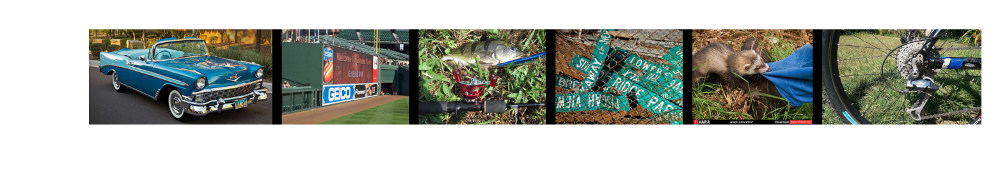

1/ILSVRC2012_val_00018317.JPEG
437/ILSVRC2012_val_00048556.JPEG
582/ILSVRC2012_val_00029201.JPEG
582/ILSVRC2012_val_00032078.JPEG
437/ILSVRC2012_val_00038055.JPEG
512/ILSVRC2012_val_00028957.JPEG


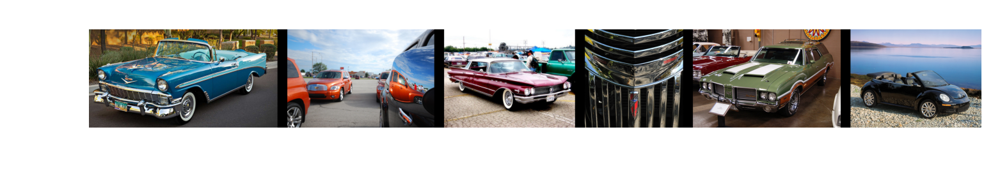

1/ILSVRC2012_val_00018317.JPEG
437/ILSVRC2012_val_00029094.JPEG
437/ILSVRC2012_val_00024318.JPEG
718/ILSVRC2012_val_00001307.JPEG
512/ILSVRC2012_val_00022770.JPEG
512/ILSVRC2012_val_00010676.JPEG


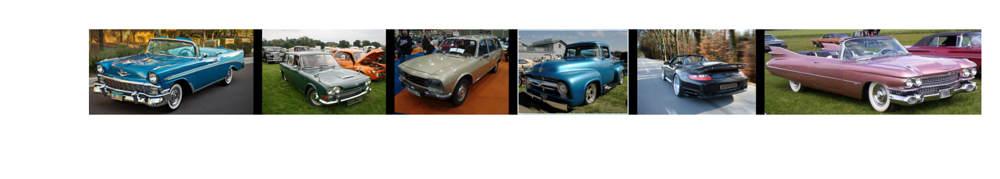

1/ILSVRC2012_val_00018317.JPEG
582/ILSVRC2012_val_00003517.JPEG
437/ILSVRC2012_val_00038055.JPEG
582/ILSVRC2012_val_00041036.JPEG
582/ILSVRC2012_val_00017520.JPEG
582/ILSVRC2012_val_00032078.JPEG


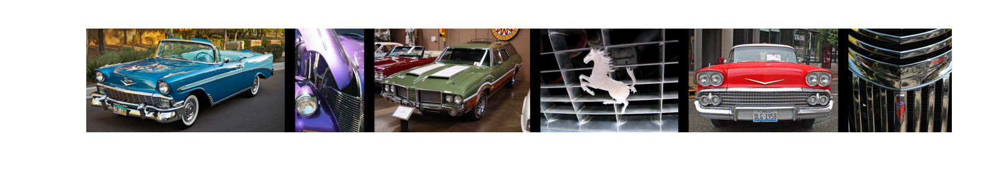

1/ILSVRC2012_val_00018317.JPEG
437/ILSVRC2012_val_00038055.JPEG
512/ILSVRC2012_val_00036091.JPEG
582/ILSVRC2012_val_00009300.JPEG
582/ILSVRC2012_val_00041276.JPEG
582/ILSVRC2012_val_00040302.JPEG


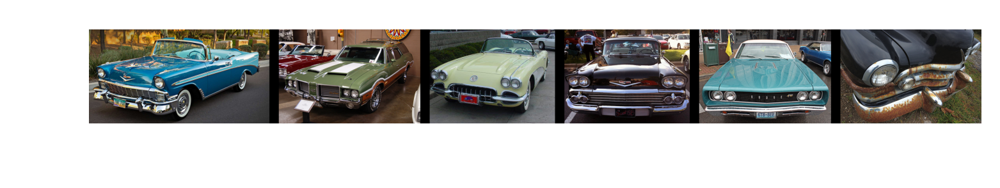

1/ILSVRC2012_val_00018317.JPEG
312/ILSVRC2012_val_00031573.JPEG
118/ILSVRC2012_val_00034901.JPEG
397/ILSVRC2012_val_00026770.JPEG
110/ILSVRC2012_val_00017794.JPEG
29/ILSVRC2012_val_00015709.JPEG


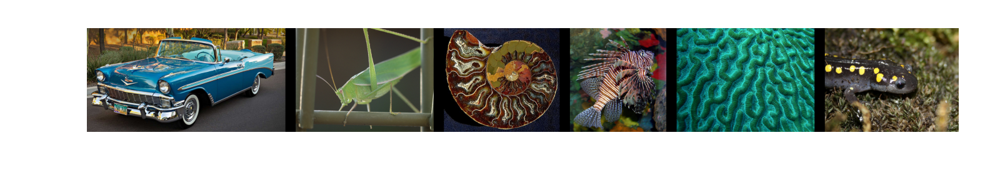

1/ILSVRC2012_val_00018317.JPEG
595/ILSVRC2012_val_00042991.JPEG
408/ILSVRC2012_val_00016090.JPEG
429/ILSVRC2012_val_00015341.JPEG
610/ILSVRC2012_val_00022261.JPEG
920/ILSVRC2012_val_00011435.JPEG


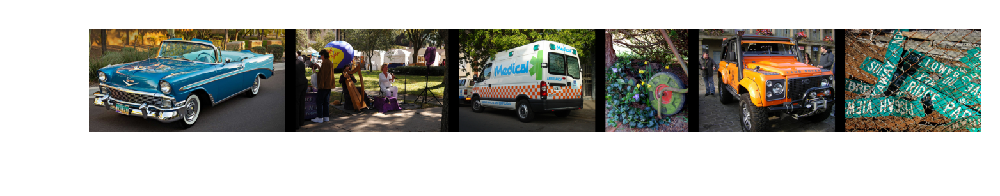

1/ILSVRC2012_val_00018317.JPEG
759/ILSVRC2012_val_00038499.JPEG
408/ILSVRC2012_val_00016090.JPEG
429/ILSVRC2012_val_00015341.JPEG
737/ILSVRC2012_val_00023590.JPEG
875/ILSVRC2012_val_00000833.JPEG


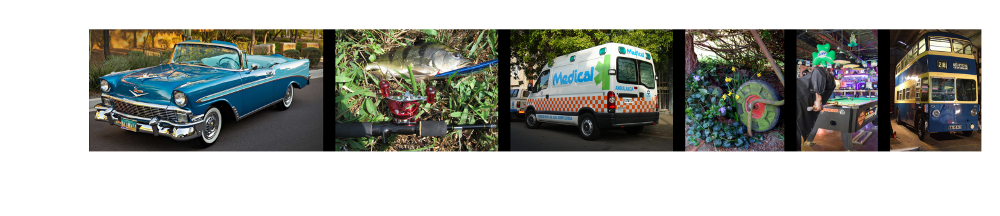

1/ILSVRC2012_val_00018317.JPEG
333/ILSVRC2012_val_00044103.JPEG
259/ILSVRC2012_val_00029610.JPEG
259/ILSVRC2012_val_00022266.JPEG
259/ILSVRC2012_val_00023884.JPEG
284/ILSVRC2012_val_00001101.JPEG


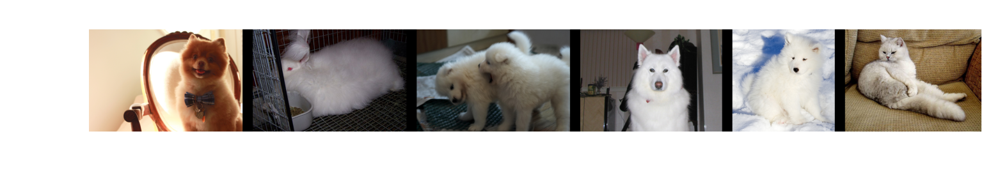

1/ILSVRC2012_val_00018317.JPEG
259/ILSVRC2012_val_00003808.JPEG
261/ILSVRC2012_val_00045838.JPEG
373/ILSVRC2012_val_00016257.JPEG
261/ILSVRC2012_val_00045687.JPEG
232/ILSVRC2012_val_00031799.JPEG


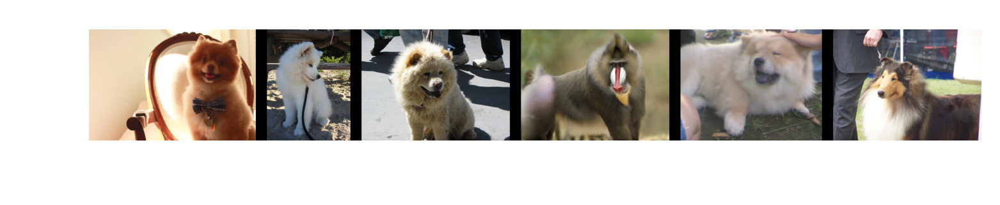

1/ILSVRC2012_val_00018317.JPEG
259/ILSVRC2012_val_00049242.JPEG
259/ILSVRC2012_val_00033280.JPEG
259/ILSVRC2012_val_00029610.JPEG
259/ILSVRC2012_val_00033101.JPEG
259/ILSVRC2012_val_00013501.JPEG


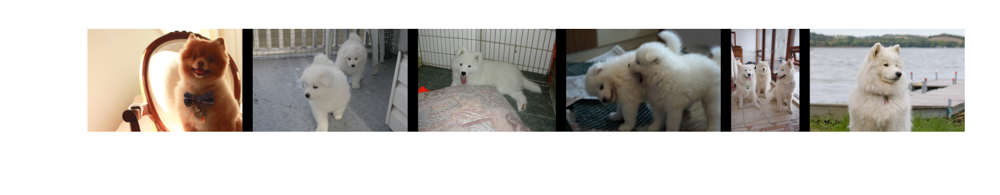

1/ILSVRC2012_val_00018317.JPEG
259/ILSVRC2012_val_00000590.JPEG
284/ILSVRC2012_val_00001101.JPEG
260/ILSVRC2012_val_00022376.JPEG
260/ILSVRC2012_val_00045514.JPEG
280/ILSVRC2012_val_00014825.JPEG


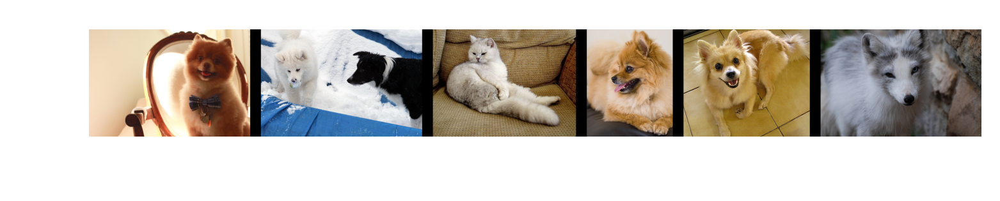

1/ILSVRC2012_val_00018317.JPEG
318/ILSVRC2012_val_00030294.JPEG
80/ILSVRC2012_val_00011861.JPEG
124/ILSVRC2012_val_00008156.JPEG
579/ILSVRC2012_val_00047427.JPEG
641/ILSVRC2012_val_00026555.JPEG


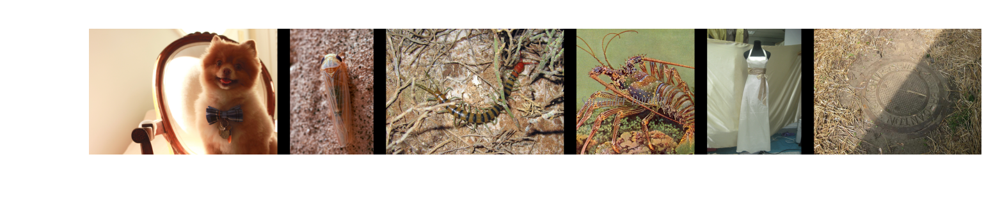

1/ILSVRC2012_val_00018317.JPEG
612/ILSVRC2012_val_00009008.JPEG
598/ILSVRC2012_val_00035839.JPEG
246/ILSVRC2012_val_00005327.JPEG
243/ILSVRC2012_val_00009553.JPEG
28/ILSVRC2012_val_00023450.JPEG


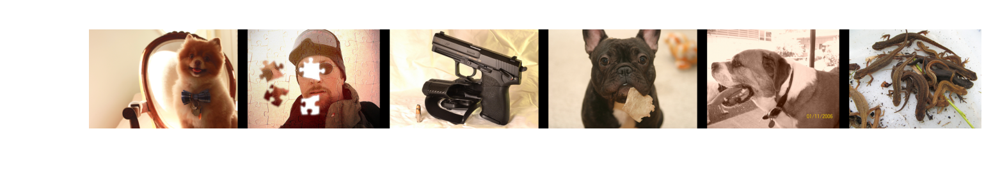

1/ILSVRC2012_val_00018317.JPEG
598/ILSVRC2012_val_00006442.JPEG
939/ILSVRC2012_val_00035149.JPEG
807/ILSVRC2012_val_00030373.JPEG
605/ILSVRC2012_val_00036098.JPEG
383/ILSVRC2012_val_00042708.JPEG


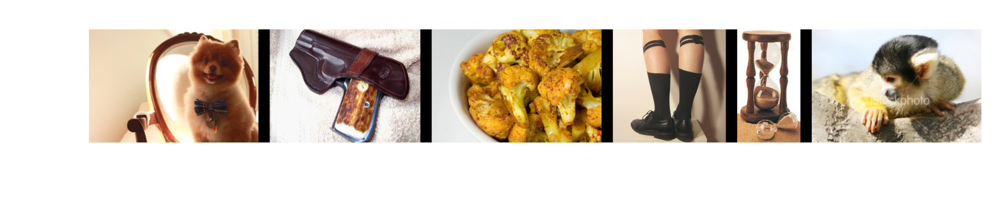

1/ILSVRC2012_val_00018317.JPEG
896/ILSVRC2012_val_00003293.JPEG
405/ILSVRC2012_val_00033161.JPEG
896/ILSVRC2012_val_00012932.JPEG
896/ILSVRC2012_val_00015306.JPEG
896/ILSVRC2012_val_00020759.JPEG


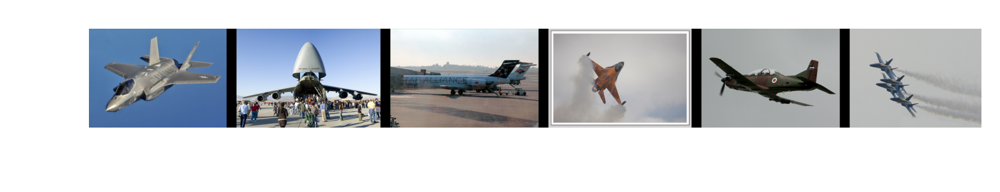

1/ILSVRC2012_val_00018317.JPEG
405/ILSVRC2012_val_00023781.JPEG
909/ILSVRC2012_val_00045983.JPEG
896/ILSVRC2012_val_00015306.JPEG
896/ILSVRC2012_val_00039785.JPEG
405/ILSVRC2012_val_00010597.JPEG


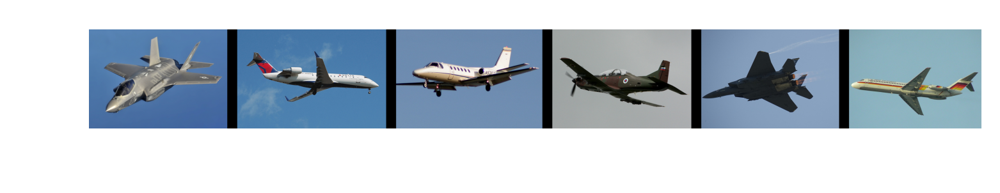

1/ILSVRC2012_val_00018317.JPEG
896/ILSVRC2012_val_00027681.JPEG
896/ILSVRC2012_val_00046026.JPEG
896/ILSVRC2012_val_00007311.JPEG
896/ILSVRC2012_val_00035119.JPEG
896/ILSVRC2012_val_00028193.JPEG


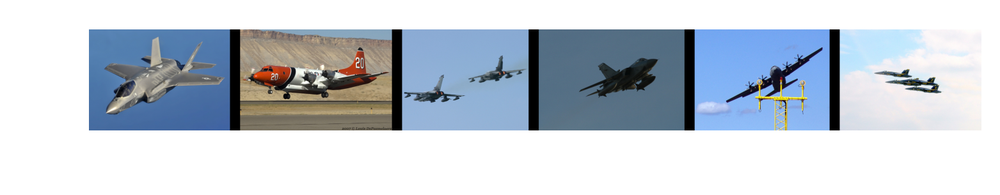

1/ILSVRC2012_val_00018317.JPEG
896/ILSVRC2012_val_00007311.JPEG
896/ILSVRC2012_val_00021062.JPEG
896/ILSVRC2012_val_00035119.JPEG
896/ILSVRC2012_val_00003293.JPEG
405/ILSVRC2012_val_00022975.JPEG


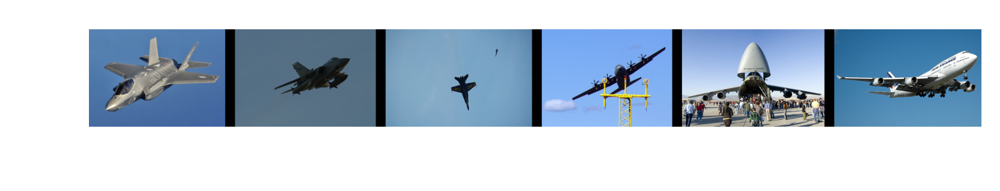

1/ILSVRC2012_val_00018317.JPEG
328/ILSVRC2012_val_00014059.JPEG
149/ILSVRC2012_val_00048794.JPEG
396/ILSVRC2012_val_00017079.JPEG
148/ILSVRC2012_val_00047167.JPEG
541/ILSVRC2012_val_00035567.JPEG


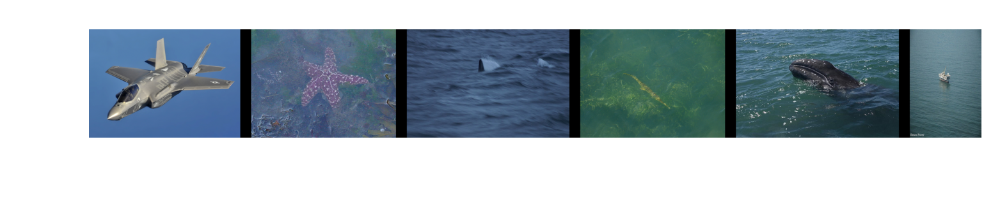

1/ILSVRC2012_val_00018317.JPEG
22/ILSVRC2012_val_00000073.JPEG
869/ILSVRC2012_val_00040391.JPEG
191/ILSVRC2012_val_00033489.JPEG
903/ILSVRC2012_val_00032728.JPEG
205/ILSVRC2012_val_00048235.JPEG


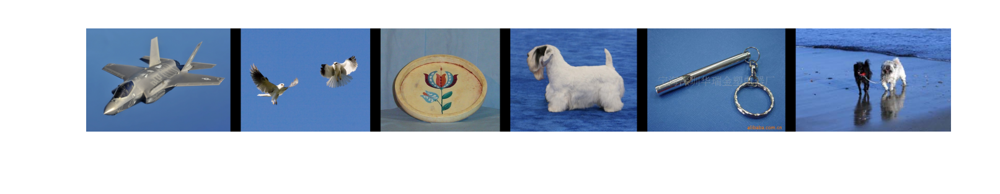

1/ILSVRC2012_val_00018317.JPEG
869/ILSVRC2012_val_00040391.JPEG
696/ILSVRC2012_val_00007293.JPEG
784/ILSVRC2012_val_00008610.JPEG
541/ILSVRC2012_val_00035210.JPEG
359/ILSVRC2012_val_00023519.JPEG


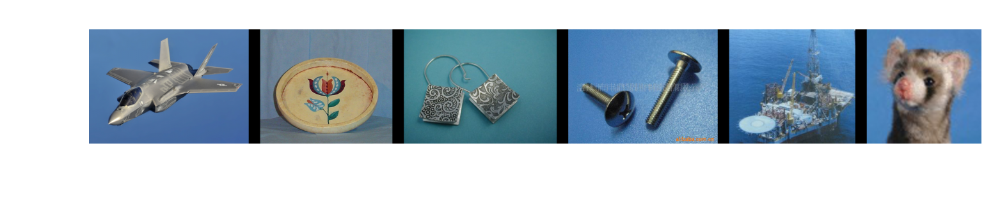

1/ILSVRC2012_val_00018317.JPEG
52/ILSVRC2012_val_00017962.JPEG
243/ILSVRC2012_val_00015355.JPEG
839/ILSVRC2012_val_00016521.JPEG
820/ILSVRC2012_val_00005320.JPEG
207/ILSVRC2012_val_00036808.JPEG


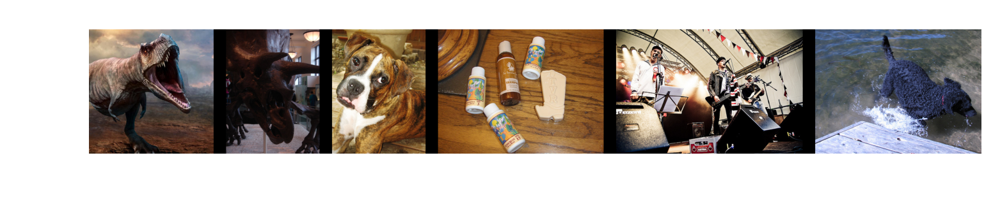

1/ILSVRC2012_val_00018317.JPEG
179/ILSVRC2012_val_00030648.JPEG
49/ILSVRC2012_val_00005180.JPEG
273/ILSVRC2012_val_00006092.JPEG
160/ILSVRC2012_val_00036907.JPEG
269/ILSVRC2012_val_00001917.JPEG


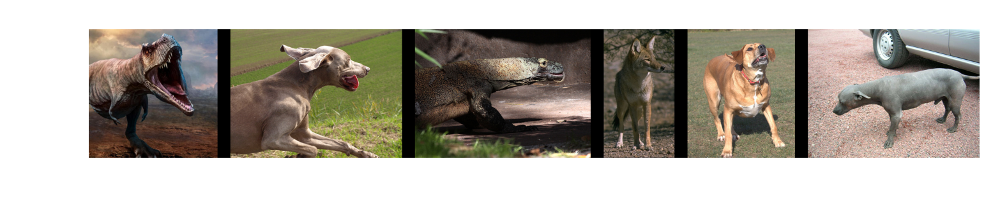

1/ILSVRC2012_val_00018317.JPEG
244/ILSVRC2012_val_00022776.JPEG
181/ILSVRC2012_val_00040673.JPEG
243/ILSVRC2012_val_00009189.JPEG
243/ILSVRC2012_val_00020841.JPEG
164/ILSVRC2012_val_00044605.JPEG


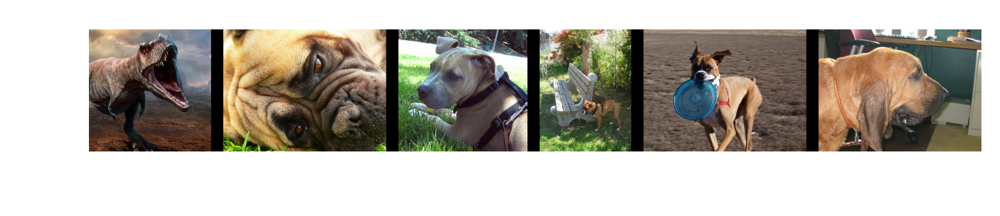

1/ILSVRC2012_val_00018317.JPEG
181/ILSVRC2012_val_00040673.JPEG
244/ILSVRC2012_val_00035569.JPEG
102/ILSVRC2012_val_00033088.JPEG
386/ILSVRC2012_val_00022872.JPEG
387/ILSVRC2012_val_00025941.JPEG


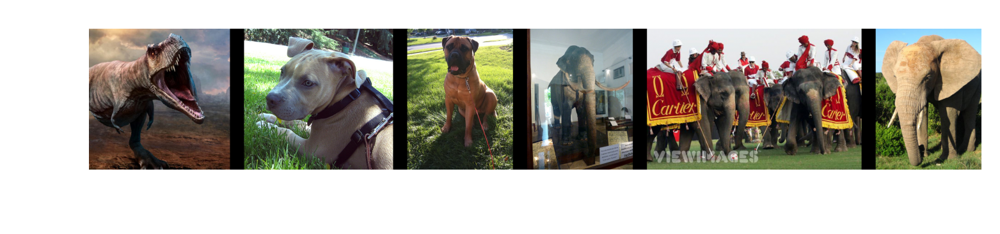

1/ILSVRC2012_val_00018317.JPEG
423/ILSVRC2012_val_00016261.JPEG
52/ILSVRC2012_val_00021164.JPEG
622/ILSVRC2012_val_00023077.JPEG
344/ILSVRC2012_val_00003341.JPEG
388/ILSVRC2012_val_00018431.JPEG


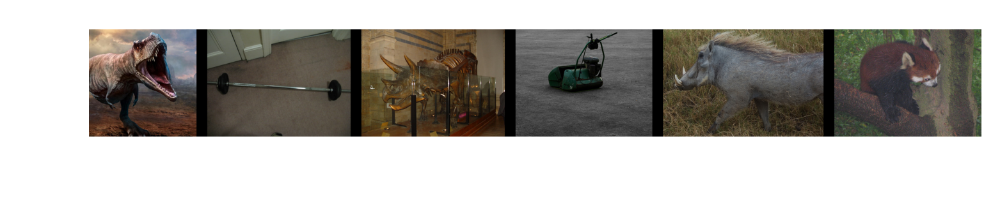

1/ILSVRC2012_val_00018317.JPEG
262/ILSVRC2012_val_00018521.JPEG
354/ILSVRC2012_val_00024266.JPEG
757/ILSVRC2012_val_00025514.JPEG
692/ILSVRC2012_val_00007694.JPEG
351/ILSVRC2012_val_00025770.JPEG


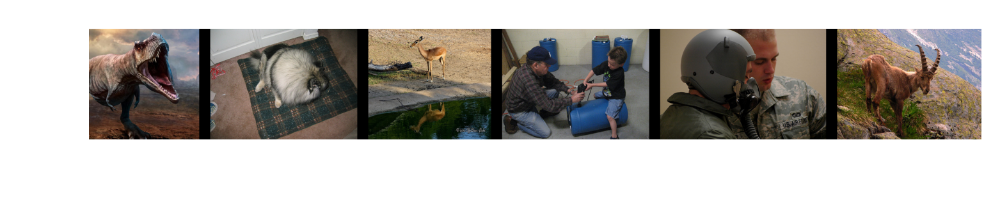

1/ILSVRC2012_val_00018317.JPEG
59/ILSVRC2012_val_00047243.JPEG
370/ILSVRC2012_val_00040264.JPEG
94/ILSVRC2012_val_00024914.JPEG
262/ILSVRC2012_val_00021218.JPEG
262/ILSVRC2012_val_00018521.JPEG


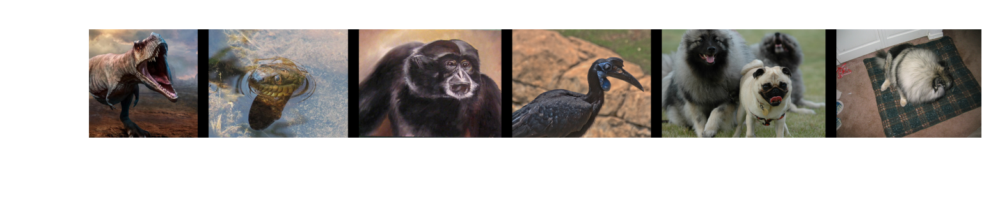

In [12]:
# # resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 5)

# # resnet_2048_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# resnet_2048_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)
# resnet_2048_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 5)

# # combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)
# combined_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 5)

# # combined_weighted_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# combined_weighted_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)
# combined_weighted_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 5)



# # ae_bottleneck_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# ae_bottleneck_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)

# # ae_dense_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# ae_dense_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)

# # ae_simple_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 5)
# ae_simple_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 5)

query_paths = ["/Users/ChrisPenny/Downloads/fxslide3.jpg",
               "/Users/ChrisPenny/Downloads/fxslide3 copy.jpg",
               "/Users/ChrisPenny/Desktop/IMG_3657.jpg",
               "/Users/ChrisPenny/Downloads/F-35A_flight_(cropped).jpg",
               "/Users/ChrisPenny/Downloads/1583454329186.jpeg"
              ]

for query_img_path in query_paths:
    resnet_1000_searcher.encoder_search(query_img_path, 5)
    resnet_2048_searcher.encoder_search(query_img_path, 5)
    combined_searcher.encoder_search(query_img_path, 5)
    combined_weighted_searcher.encoder_search(query_img_path, 5)
    ae_bottleneck_searcher.encoder_search(query_img_path, 5)
    ae_dense_searcher.encoder_search(query_img_path, 5)
    ae_simple_searcher.encoder_search(query_img_path, 5)
    
#     "/Users/ChrisPenny/Downloads/F-35A_flight_(cropped).jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1583454329186.jpeg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/180219103122-zanzibar-and-its-islands---mnemba-a-view-from-the-sky-mnemba-island-lodge.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/images.jpeg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/coca-cola-coke-coca-cola.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0 copy.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0.jpg", 10)

In [ ]:
# Run Timing Analysis:
# resnet_1000_searcher.build_annoy_forest(10)
# resnet_1000_searcher.score_runtimes('annoy')
# resnet_1000_searcher.build_annoy_forest(100)
# resnet_1000_searcher.score_runtimes('annoy')
# resnet_1000_searcher.build_annoy_forest(1000)
# resnet_1000_searcher.score_runtimes('annoy')

# resnet_1000_searcher.score_runtimes('brute_force')

resnet_1000_searcher.score_runtimes('distributed')


In [ ]:
resnet_1000_searcher.score_runtimes('distributed')

In [ ]:
# ae_bottleneck_searcher.load_encoder()
# ae_dense_searcher.load_encoder()
# ae_simple_searcher.load_encoder()

In [ ]:
# ae_bottleneck_searcher.generate_reconstruction("/Users/ChrisPenny/Downloads/images (2).jpeg")

# ae_bottleneck_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 4.59.10 PM.png")
# ae_dense_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 4.59.10 PM.png")
# ae_simple_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 4.59.10 PM.png")

# ae_bottleneck_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.06.56 PM.png")
# ae_dense_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.06.56 PM.png")
# ae_simple_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.06.56 PM.png")

# ae_bottleneck_searcher.generate_reconstruction("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg")
# ae_dense_searcher.generate_reconstruction("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg")
# ae_simple_searcher.generate_reconstruction("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg")

ae_bottleneck_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.16.02 PM.png")
ae_dense_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.16.02 PM.png")
ae_simple_searcher.generate_reconstruction("/Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.16.02 PM.png")


# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg", 10)
# /Users/ChrisPenny/Desktop/Screen Shot 2020-11-28 at 6.16.02 PM.png

In [ ]:
# def distributed_search(searcher, query_index, num_results, cluster_id = 'local'):

#     # Query vector:
#     query_vec = searcher._values[query_index]
#     query_vec_str = ''
#     for elem in query_vec:
#         query_vec_str += str(elem) + ' '
#     query_vec_str = query_vec_str[:-1]
# #         print(query_vec_str)

#     f = open("vec.txt","w")
#     f.write(query_vec_str)

#     if cluster_id == 'local':
#         print('Running locally')
#         subprocess.run("python3 distributed_prototype_local.py " + 
#                        str(searcher._src) + 
#                        " -r local " + 
#                        "--region=us-east-2 --query=vec.txt > output.txt", 
#                        shell = True)
#     else:

#         subprocess.run("python3 distributed_prototype.py " + 
#                        str(searcher._s3_path) + 
#                        " -r emr --cluster-id=" + 
#                        str(cluster_id) + 
#                        " --no-read-logs --region=us-east-2 --query=vec.txt > output.txt", 
#                        shell = True)


#     with open('output.txt') as f:
#         for line in f:
#             out = list(str(line).replace('[','').
#                                  replace(']','').
#                                  replace(',', '').
#                                  replace('"','').
#                                  replace('1\t','').
#                                  replace('\n', '').split(" "))

# #         print(out[1::2])
#         out_paths = out[1::2]
# #         if show_flag == 1:
# #         for item in out[1::2]:
# #             img = PIL.Image.open(searcher._image_dir + item)

# #             plt.clf()
# #             plt.imshow(img)
# #             plt.show()
#         query_img = PIL.Image.open(searcher._image_dir + out_paths[0])

#         concat_img = np.array(query_img.resize((int((600/query_img.height)*query_img.width), 600)))

#         for i in range(1, num_results + 1):
#             result_path = out_paths[i]
#             result_img = PIL.Image.open(searcher._image_dir + result_path)
#             result_img = result_img.resize((int((600/result_img.height)*result_img.width), 600))

#             if len(np.array(result_img).shape) == 2:
#                 result_img = np.stack([result_img, result_img, result_img], axis = -1)
#             elif np.array(result_img).shape == (224, 224, 4):
#                 result_img = np.array(result_img)
#                 result_img = result_img[:, :, 0:3]


#             concat_img = np.concatenate([concat_img, np.zeros((600, 60, 3)), result_img], axis = 1)

#         plt.clf()
#         plt.imshow(concat_img/255)
#         plt.show()

# # distributed_search(resnet_1000_searcher, 55, 5)
# distributed_search(resnet_1000_searcher, 55, 5, cluster_id = 'j-1GZDDMO5LWTZ7')

In [ ]:
# resnet_1000_searcher.load_encoder()
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/7MileBeach-2013-HiRes.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/F-35A_flight_(cropped).jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/1583454329186.jpeg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/180219103122-zanzibar-and-its-islands---mnemba-a-view-from-the-sky-mnemba-island-lodge.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/images.jpeg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/coca-cola-coke-coca-cola.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0 copy.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0.jpg", 10)
resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (2) copy.jpeg", 10)
resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (2).jpeg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/Van-Gogh-starry-night-print2.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/cb4b3ea65d0b315e153116ecd9043070.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/366ad6eb4f5923b3148f2ae7616f1225.jpg", 10)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/Dogs+and+Puppies+%27Mona+Lisa+Pet%27+Graphic+Art+Print+on+Wrapped+Canvas.jpg", 5)
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (1).jpeg", 5)

# /Users/ChrisPenny/Downloads/images (1).jpeg

# combined_searcher.load_encoder()
# combined_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/7MileBeach-2013-HiRes.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/F-35A_flight_(cropped).jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1583454329186.jpeg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/180219103122-zanzibar-and-its-islands---mnemba-a-view-from-the-sky-mnemba-island-lodge.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/images.jpeg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Smashburger-recipe-120219.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/coca-cola-coke-coca-cola.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fxslide3 copy.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0 copy.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0.jpg", 10)
combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (2) copy.jpeg", 10)
combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (2).jpeg", 10)

# /Users/ChrisPenny/Downloads/images (2).jpeg

# /Users/ChrisPenny/Downloads/1-corvette-stingray-c8-2019-fd-hr-hero-front_0.jpg
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Parking-lot-photo-e1580338586257.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/IMG_2943_0.jpeg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/920x920.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/best-time-to-see-the-eagles-in-red-wing-mn-e1573503128460.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Starry-Night-canvas-Vincent-van-Gogh-New-1889.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Van-Gogh-starry-night-print2.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/cb4b3ea65d0b315e153116ecd9043070.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/366ad6eb4f5923b3148f2ae7616f1225.jpg", 10)

# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/fa7ffb75d3f227e86171003113a26bd3.jpg", 10)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/41d1giSZH1L.jpg", 5)
# /Users/ChrisPenny/Downloads/41d1giSZH1L.jpg
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/Dogs+and+Puppies+%27Mona+Lisa+Pet%27+Graphic+Art+Print+on+Wrapped+Canvas.jpg", 5)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/images (1).jpeg", 5)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/il_570xN.590011994_dmmh.jpg", 5)
# /Users/ChrisPenny/Downloads/il_570xN.590011994_dmmh.jpg



In [ ]:
# resnet_1000_searcher.build_annoy_forest(10000)
# resnet_2048_searcher.build_annoy_forest(10000)
# combined_searcher.build_annoy_forest(10000)
# ae_bottleneck_searcher.build_annoy_forest(10000)
# ae_dense_searcher.build_annoy_forest(10000)
# ae_simple_searcher.build_annoy_forest(10000)

# resnet_1000_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_2048_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_dense_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)

# resnet_1000_searcher.build_annoy_forest(1000)
# resnet_1000_normalized_searcher.build_annoy_forest(1000)
# resnet_2048_searcher.build_annoy_forest(1000)
# combined_searcher.build_annoy_forest(1000)
# combined_weighted_searcher.build_annoy_forest(1000)
# ae_bottleneck_searcher.build_annoy_forest(1000)
# ae_dense_searcher.build_annoy_forest(1000)
# ae_simple_searcher.build_annoy_forest(1000)

# resnet_1000_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_1000_normalized_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_2048_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_weighted_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_dense_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)

# resnet_1000_searcher.build_annoy_forest(100)
# resnet_1000_normalized_searcher.build_annoy_forest(100)
# resnet_2048_searcher.build_annoy_forest(100)
# combined_searcher.build_annoy_forest(100)
# combined_weighted_searcher.build_annoy_forest(100)
# ae_bottleneck_searcher.build_annoy_forest(100)
# ae_dense_searcher.build_annoy_forest(100)
# ae_simple_searcher.build_annoy_forest(100)

# resnet_1000_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_1000_normalized_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_2048_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_weighted_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_dense_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)

# resnet_1000_searcher.build_annoy_forest(10)
# resnet_1000_normalized_searcher.build_annoy_forest(10)
# resnet_2048_searcher.build_annoy_forest(10)
# combined_searcher.build_annoy_forest(10)
# combined_weighted_searcher.build_annoy_forest(10)
# ae_bottleneck_searcher.build_annoy_forest(10)
# ae_dense_searcher.build_annoy_forest(10)
# ae_simple_searcher.build_annoy_forest(10)

# resnet_1000_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_1000_normalized_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# resnet_2048_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# combined_weighted_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_dense_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)

In [ ]:
# resnet_searcher.save_scores(search_mode = 'brute_force', normalized = True, ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'brute_force', normalized = True, ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'brute_force', normalized = True, ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'brute_force', normalized = True, ranks = [5, 10, 20, 50], num_classes=1000)

# resnet_searcher.save_scores(search_mode = 'brute_force', normalized = False, ranks = [5, 10, 20, 50], num_classes=1000)
# combined_searcher.save_scores(search_mode = 'brute_force', normalized = False, ranks = [5, 10, 20, 50], num_classes=1000)
# ae_bottleneck_searcher.save_scores(search_mode = 'brute_force', normalized = False, ranks = [5, 10, 20, 50], num_classes=1000)
# ae_simple_searcher.save_scores(search_mode = 'brute_force', normalized = False, ranks = [5, 10, 20, 50], num_classes=1000)

In [ ]:
# resnet_1000_searcher.build_annoy_forest(10000)
combined_searcher.build_annoy_forest(1000)
# ae_bottleneck_searcher.build_annoy_forest(10000)

In [ ]:
# resnet_1000_searcher.load_encoder()
# resnet_1000_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 20)

# ae_bottleneck_searcher.load_encoder()
# ae_bottleneck_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 10)

combined_searcher.load_encoder()
combined_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 20)
# combined_searcher.encoder_search("/Users/ChrisPenny/Downloads/7MileBeach-2013-HiRes.jpg", 10)

In [ ]:
# combined_searcher.save_scores(search_mode = 'annoy', ranks = [5, 10, 20, 50], num_classes=1000)

In [ ]:
def process_scores(self, search_mode, ranks = [5, 10, 20, 50]):
    
    score_src = search_mode + "_" + self.encoding_type + "_scores.txt"
    
    with open(score_src) as f:
        loaded_scores =  json.load(f)

    def map_at_rank(rank):

        class_averages = []

        for (k, v) in loaded_scores.items():
            class_averages.append(np.mean(v[rank]))

        return np.mean(class_averages)#, np.argsort(class_averages)[::-1]
    
    return map_at_rank('5'), map_at_rank('10'), map_at_rank('20')

print(process_scores(resnet_searcher, 'annoy'))
print(process_scores(combined_searcher, 'annoy'))

In [ ]:
search_idx = np.random.randint(0,50000)

print(search_idx)

resnet_searcher.brute_force_search_index(query_index=search_idx, num_results=5, show_flag=1)
print('-----')
combined_searcher.brute_force_search_index(query_index=search_idx, num_results=5, show_flag=1)

# 18759
# 40728

In [ ]:
# resnet_searcher.load_encoder()
# resnet_searcher.encoder_search("/Users/ChrisPenny/Desktop/IMG_3657.jpg", 10)

In [ ]:
# searcher1.brute_force_search_index(query_index=1600, num_results=5, show_flag=1)
# searcher.brute_force_search_index(query_index=1593, num_results=5, show_flag=1)
# searcher1.brute_force_search_index(query_index=1605, num_results=5, show_flag=1)
# searcher.brute_force_search_index(query_index=1605, num_results=5, show_flag=1)

# searcher1.brute_force_search_index(query_index=45608, num_results=5, show_flag=1)
# print('-----')
# searcher.brute_force_search_index(query_index=45608, num_results=5, show_flag=1)

# searcher1.brute_force_search_index(query_index=9100, num_results=5, show_flag=1)
# print('-----')
# searcher.brute_force_search_index(query_index=9100, num_results=5, show_flag=1, normalized = True)

searcher1.brute_force_search_index(query_index=981, num_results=5, show_flag=1)
print('-----')
searcher.brute_force_search_index(query_index=981, num_results=5, show_flag=1, normalized = True)

In [ ]:
searcher.build_annoy_forest(10, 'test.ann')

In [ ]:
# searcher.annoy_search_index(query_index=601, num_results=5, show_flag=1)

searcher.annoy_search_index(query_index=6016, num_results=5, show_flag=1)

In [ ]:
searcher.annoy_search_index(query_index=600, num_results=5, show_flag=1)

In [ ]:
searcher.distributed_search(9901, 20, 'j-3HHZFA4CQZND8')

In [ ]:
with open('output.txt') as f:
    for line in f:
        out = list(str(line).replace('[','').
                             replace(']','').
                             replace(',', '').
                             replace('"','').
                             replace('1\t','').
                             replace('\n', '').split(" "))
        
print(out[1::2])

In [ ]:
with open('./vec.txt') as f:
    for line in f:
        out = line.split(" ")

out = [float(x) for x in out]
print(out)

In [ ]:
import tensorflow
import tensorflow as tf
import tensorflow.keras as keras
import tensorflow.keras.applications as ka

In [ ]:
testModel = keras.models.load_model('/Users/ChrisPenny/Downloads/AE_Bottleneck_F4_0001_Final.h5')

testModel.summary()

In [ ]:


# encoderModel = keras.Model(inputs = testModel.input, 
#                            outputs = keras.layers.GlobalMaxPool2D()
#                            (testModel.layers[-12].output))

encoderModel = keras.Model(inputs = testModel.input, 
                           outputs = testModel.layers[-15].output)

encoderModel.compile()

encoderModel.summary()

# for layer in testModel.layers:
#     print(layer.name)
    
# testModel.layers[-15].name

# out

In [ ]:
# query_url =  "/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/9/ILSVRC2012_val_00027762.JPEG"

# query_url = "/Users/ChrisPenny/Desktop/IMG_3657.jpg"


# out = testModel.predict(np_im)



# print(len(encoding[0]))

# plt.clf()
# plt.imshow(np_im[0]/255)
# plt.show()


# plt.clf()
# plt.imshow(out[0]/255)
# plt.show()

In [ ]:
# images = '/Users/ChrisPenny/Documents/MPCS53112/project_dir/ImageNet/organized_validation_resnet/'

# im = PIL.Image.open(query_url)
# im_resize = im.resize((224, 224))
# np_im = np.array(im_resize).reshape((1, 224, 224, 3))




In [ ]:
cwd = os.getcwd()
cwd += '/ImageNet/organized_validation_resnet/'

files_all = []

for i in range(1,1001):
    files = os.listdir(cwd + str(i))  # Get all the files in that directory
    files_all += [str(i) + '/' + x for x in files]


encodings_dict = {}

for idx in range(49000, len(files_all)):
    
    if idx % 1000 == 0:
        print(idx)
    
    path = cwd + files_all[idx]
    im = PIL.Image.open(path)
    im_resize = im.resize((224, 224))
    if np.array(im_resize).shape == (224, 224):
        im_resize = np.stack([im_resize, im_resize, im_resize], axis = -1)
    elif np.array(im_resize).shape == (224, 224, 4):
        im_resize = np.array(im_resize)
        im_resize = im_resize[:, :, 0:3]
    np_im = np.array(im_resize).reshape((1, 224, 224, 3))
    
    out = self._encoderModel.predict(np_im)
    
    encodings_dict[files_all[idx]] = list([float(x) for x in out[0]])
    
with open('/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/DEBUG_ae_bottleneck_validation_2048.txt', 'w') as outfile:
    json.dump(encodings_dict, outfile)
        

In [ ]:
with open('/Users/ChrisPenny/Documents/MPCS53112/project_dir/encodings/DEBUG_ae_bottleneck_validation_2048.txt', 'w') as outfile:
    json.dump(encodings_dict, outfile)

In [ ]:
underlyingModel = keras.models.load_model(
                        './models/AE_Dense_F4_0001_Final.h5')

In [ ]:
underlyingModel.summary()